In [34]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn import preprocessing
from scipy import stats
import scipy as sp

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

from sklearn.metrics import accuracy_score,f1_score,log_loss,classification_report,confusion_matrix,jaccard_similarity_score


print('Libraries imported.')

Libraries imported.


In [35]:
data="/resources/Capstone Project/Data-Collisions.csv"

collisions = pd.read_csv(data)
collisions.head()

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3072: DtypeWarning: Columns (33) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


,SEVERITYCODE,X,Y,OBJECTID,INCKEY,COLDETKEY,REPORTNO,STATUS,ADDRTYPE,INTKEY,...,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,ST_COLCODE,ST_COLDESC,SEGLANEKEY,CROSSWALKKEY,HITPARKEDCAR
0,2,-122.323148,47.703140,1,1307,1307,3502005,Matched,Intersection,37475.0,...,Wet,Daylight,NaN,NaN,NaN,10,Entering at angle,0,0,N
1,1,-122.347294,47.647172,2,52200,52200,2607959,Matched,Block,NaN,...,Wet,Dark - Street Lights On,NaN,6354039.0,NaN,11,From same direction - both going straight - bo...,0,0,N
2,1,-122.334540,47.607871,3,26700,26700,1482393,Matched,Block,NaN,...,Dry,Daylight,NaN,4323031.0,NaN,32,One parked--one moving,0,0,N
3,1,-122.334803,47.604803,4,1144,1144,3503937,Matched,Block,NaN,...,Dry,Daylight,NaN,NaN,NaN,23,From same direction - all others,0,0,N
4,2,-122.306426,47.545739,5,17700,17700,1807429,Matched,Intersection,34387.0,...,Wet,Daylight,NaN,4028032.0,NaN,10,Entering at angle,0,0,N


In [5]:
print(collisions.shape)

(194673, 38)


In [32]:
collisions["SEVERITYCODE"].value_counts()

1    136485
2     58188
Name: SEVERITYCODE, dtype: int64

### Data Cleaning

As we are only interested in accidents which involves cycles or pedestrian, we remove other related accidentes.

In [6]:
collisions['COLLISIONTYPE'].value_counts(dropna=False)

Parked Car    47987
Angles        34674
Rear Ended    34090
Other         23703
Sideswipe     18609
Left Turn     13703
Pedestrian     6608
Cycles         5415
NaN            4904
Right Turn     2956
Head On        2024
Name: COLLISIONTYPE, dtype: int64

In [36]:
main_df=collisions[collisions.COLLISIONTYPE == 'Pedestrian']
main_df=main_df.append(collisions[collisions.COLLISIONTYPE == 'Cycles'])
main_df=main_df[main_df.STATUS=='Matched']
main_df=main_df.drop(['OBJECTID','LOCATION','SEVERITYCODE.1','INCKEY','COLDETKEY','REPORTNO','STATUS','ADDRTYPE','INTKEY','EXCEPTRSNCODE','EXCEPTRSNDESC','INCDATE','SDOT_COLDESC','ST_COLCODE','ST_COLDESC','CROSSWALKKEY','SEGLANEKEY','HITPARKEDCAR'],axis=1)
print(main_df.shape)

(12022, 20)


In [27]:
main_df['SEVERITYCODE'].value_counts(dropna=False)

2    10679
1     1343
Name: SEVERITYCODE, dtype: int64

### Data Analysis


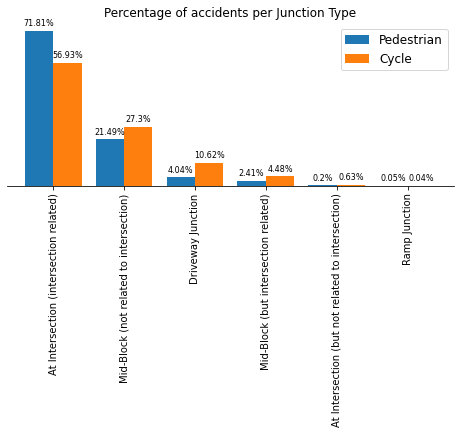

In [28]:
#Analysis of junction accidents probability

junct_p=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Pedestrian']['JUNCTIONTYPE'].value_counts())
junct_c=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Cycles']['JUNCTIONTYPE'].value_counts())

junct_p.rename(columns={"JUNCTIONTYPE":"Pedestrian"}, inplace=True)

junct_df=junct_p
junct_df['Cycle']=junct_c.JUNCTIONTYPE

#Tranform values to percentages
junct_df['Pedestrian']=((junct_df['Pedestrian']/junct_df['Pedestrian'].sum())*100).round(2)
junct_df['Cycle']=((junct_df['Cycle']/junct_df['Cycle'].sum())*100).round(2)

graph=junct_df.plot(kind='bar', figsize=(8,3), width=0.8)
graph.set_title('Percentage of accidents per Junction Type', fontsize=12)
graph.axes.get_yaxis().set_visible(False)
graph.set_xticklabels(junct_df.index, fontsize=10)
graph.spines["right"].set_visible(False)
graph.spines["top"].set_visible(False)
graph.spines["left"].set_visible(False)
graph.legend(fontsize=12)

rects=graph.patches

for rect in rects:
    height = rect.get_height()
    graph.annotate('{}%'.format(height),
                xy=(rect.get_x() + rect.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom',
                fontsize=8
                  )

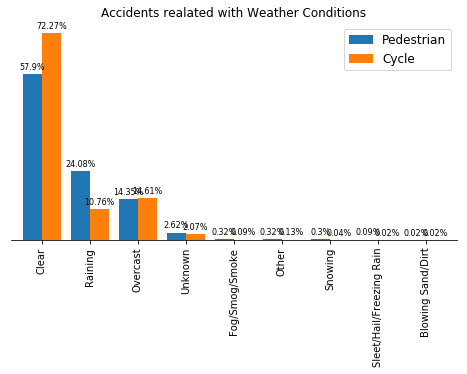

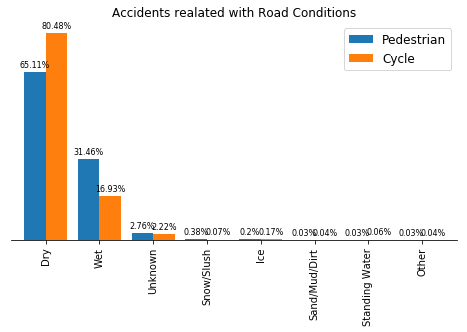

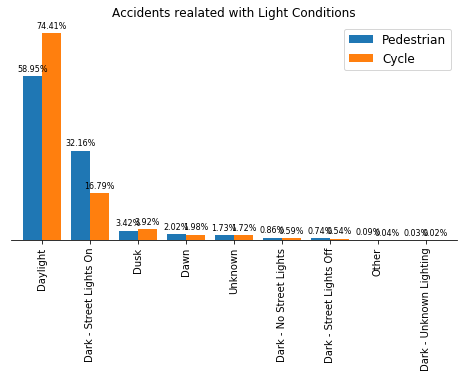

In [74]:
#Analysis of accidents probability per weather conditions

weather_p=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Pedestrian']['WEATHER'].value_counts())
weather_c=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Cycles']['WEATHER'].value_counts())

weather_p.rename(columns={"WEATHER":"Pedestrian"}, inplace=True)

weather_df=weather_p
weather_df['Cycle']=weather_c.WEATHER

#Tranform values to percentages
weather_df['Pedestrian']=((weather_df['Pedestrian']/weather_df['Pedestrian'].sum())*100).round(2)
weather_df['Cycle']=((weather_df['Cycle']/weather_df['Cycle'].sum())*100).round(2)

graph=weather_df.plot(kind='bar', figsize=(8,4), width=0.8)
graph.set_title('Accidents realated with Weather Conditions', fontsize=12)
graph.axes.get_yaxis().set_visible(False)
graph.set_xticklabels(weather_df.index, fontsize=10)
graph.spines["right"].set_visible(False)
graph.spines["top"].set_visible(False)
graph.spines["left"].set_visible(False)
graph.legend(fontsize=12)

rects=graph.patches

for rect in rects:
    height = rect.get_height()
    graph.annotate('{}%'.format(height),
                xy=(rect.get_x() + rect.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom',
                fontsize=8
                  )

    
#Analysis of accidents probability per road conditions
road_p=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Pedestrian']['ROADCOND'].value_counts())
road_c=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Cycles']['ROADCOND'].value_counts())

road_p.rename(columns={"ROADCOND":"Pedestrian"}, inplace=True)

road_df=road_p
road_df['Cycle']=road_c.ROADCOND

#Tranform values to percentages
road_df['Pedestrian']=((road_df['Pedestrian']/road_df['Pedestrian'].sum())*100).round(2)
road_df['Cycle']=((road_df['Cycle']/road_df['Cycle'].sum())*100).round(2)

graph=road_df.plot(kind='bar', figsize=(8,4), width=0.8)
graph.set_title('Accidents realated with Road Conditions', fontsize=12)
graph.axes.get_yaxis().set_visible(False)
graph.set_xticklabels(road_df.index, fontsize=10)
graph.spines["right"].set_visible(False)
graph.spines["top"].set_visible(False)
graph.spines["left"].set_visible(False)
graph.legend(fontsize=12)

rects=graph.patches

for rect in rects:
    height = rect.get_height()
    graph.annotate('{}%'.format(height),
                xy=(rect.get_x() + rect.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom',
                fontsize=8
                  )

    
#Analysis of accidents probability per light conditions
light_p=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Pedestrian']['LIGHTCOND'].value_counts())
light_c=pd.DataFrame(main_df[main_df.COLLISIONTYPE =='Cycles']['LIGHTCOND'].value_counts())

light_p.rename(columns={"LIGHTCOND":"Pedestrian"}, inplace=True)

light_df=light_p
light_df['Cycle']=light_c.LIGHTCOND

#Tranform values to percentages
light_df['Pedestrian']=((light_df['Pedestrian']/light_df['Pedestrian'].sum())*100).round(2)
light_df['Cycle']=((light_df['Cycle']/light_df['Cycle'].sum())*100).round(2)

graph=light_df.plot(kind='bar', figsize=(8,4), width=0.8)
graph.set_title('Accidents realated with Light Conditions', fontsize=12)
graph.axes.get_yaxis().set_visible(False)
graph.set_xticklabels(light_df.index, fontsize=10)
graph.spines["right"].set_visible(False)
graph.spines["top"].set_visible(False)
graph.spines["left"].set_visible(False)
graph.legend(fontsize=12)    

rects=graph.patches

for rect in rects:
    height = rect.get_height()
    graph.annotate('{}%'.format(height),
                xy=(rect.get_x() + rect.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom',
                fontsize=8
                  )

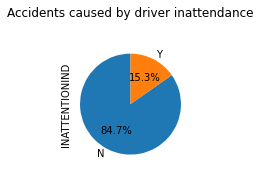

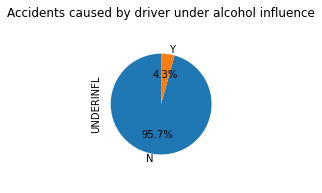

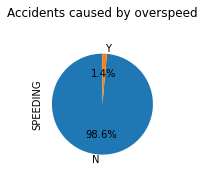

In [30]:
main_df["INATTENTIONIND"].fillna("N", inplace=True)
df_inattention=pd.DataFrame(main_df["INATTENTIONIND"].value_counts())

df_inattention["INATTENTIONIND"].plot(kind="pie",
                   figsize=(2,3),
                   autopct="%1.1f%%",
                   startangle=90
                   )
plt.title("Accidents caused by driver inattendance")
plt.axis("equal")

plt.show()

main_df["UNDERINFL"].fillna("N", inplace=True)
df_under=pd.DataFrame(main_df["UNDERINFL"].value_counts())
df_under.drop(axis=0, index="1", inplace=True)
df_under.drop(axis=0, index="0", inplace=True)

df_under["UNDERINFL"].plot(kind="pie",
                   figsize=(2,3),
                   autopct="%1.1f%%",
                   startangle=90
                   )
plt.title("Accidents caused by driver under alcohol influence")
plt.axis("equal")

plt.show()

main_df["SPEEDING"].fillna("N", inplace=True)
df_speed=pd.DataFrame(main_df["SPEEDING"].value_counts())

df_speed["SPEEDING"].plot(kind="pie",
                   figsize=(2,3),
                   autopct="%1.1f%%",
                   startangle=90
                   )
plt.title("Accidents caused by overspeed")
plt.axis("equal")

plt.show()

In [42]:
#Analysis per Accident's Location
import folium

In [32]:
pip install shapely

Note: you may need to restart the kernel to use updated packages.


In [38]:
#Allocate points in a geojson define geometries
import json
from shapely.geometry import shape, Point

main_df.dropna(subset=['X','Y'], inplace=True)
main_df["NEIGHBORHOOD"]=""

# load GeoJSON file containing sectors
with open('/resources/Capstone Project/seatle_neigh.geojson') as f:
    js = json.load(f)

for i in range(0,11928):
    point = Point(main_df["X"][i], main_df["Y"][i])
    for feature in js['features']:
        polygon = shape(feature['geometry'])
        if polygon.contains(point):
            main_df["NEIGHBORHOOD"][i]=feature["properties"]["name"]

KeyError: 0

In [39]:
neigh=pd.read_csv('/resources/Capstone Project/accidents_neigh.csv')
neigh.head()

,index,SEVERITYCODE,X,Y,SEVERITYDESC,COLLISIONTYPE,PERSONCOUNT,PEDCOUNT,PEDCYLCOUNT,VEHCOUNT,...,INATTENTIONIND,UNDERINFL,WEATHER,ROADCOND,LIGHTCOND,PEDROWNOTGRNT,SDOTCOLNUM,SPEEDING,COORDINATES,NEIGHBORHOOD
0,71,2,-122.341775,47.615265,Injury Collision,Pedestrian,2,1,0,1,...,NaN,0,Clear,Dry,Daylight,NaN,5236010.0,NaN,"47.61526498,-122.3417749",Belltown
1,84,2,-122.302233,47.599281,Injury Collision,Pedestrian,2,1,0,1,...,NaN,N,Clear,Dry,Daylight,Y,10069006.0,NaN,"47.59928129,-122.3022335",Atlantic
2,92,1,-122.320762,47.612963,Property Damage Only Collision,Pedestrian,3,1,0,1,...,NaN,N,Overcast,Wet,Dark - Street Lights On,NaN,NaN,NaN,"47.61296336,-122.3207624",First Hill
3,104,2,-122.326804,47.616708,Injury Collision,Pedestrian,2,1,0,1,...,Y,0,Clear,Dry,Dusk,NaN,9273020.0,NaN,"47.61670793,-122.32680359999999",Broadway
4,114,2,-122.315442,47.661285,Injury Collision,Pedestrian,2,1,0,1,...,NaN,N,Clear,Dry,Daylight,NaN,NaN,NaN,"47.66128458,-122.31544240000001",University District


In [40]:
general_zone=pd.DataFrame(neigh["NEIGHBORHOOD"].value_counts())
general_zone.reset_index(inplace=True)
general_zone.rename(columns={"NEIGHBORHOOD":"COUNT","index":"NEIGHBORHOOD"}, inplace=True)
general_zone

,NEIGHBORHOOD,COUNT
0,Central Business District,873
1,Broadway,843
2,University District,774
3,Belltown,720
4,Pioneer Square,422
...,...,...
85,Laurelhurst,10
86,Sand Point,7
87,North Beach - Blue Ridge,7
88,Briarcliff,6


In [44]:
seattle= "/resources/Capstone Project/seatle_neigh.geojson"

seattle_map=folium.Map(location=[47.608013, -122.335167], zoom_start=12)

seattle_map.choropleth(
    geo_data=seattle,
    data=general_zone,
    columns=['NEIGHBORHOOD', 'COUNT'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Ped/Cycles-involved accidents in Seattle'
)

seattle_map

In [54]:
cycle_zone=pd.DataFrame(neigh[neigh.COLLISIONTYPE =='Cycles']["NEIGHBORHOOD"].value_counts())
cycle_zone.reset_index(inplace=True)
cycle_zone.rename(columns={"NEIGHBORHOOD":"COUNT","index":"NEIGHBORHOOD"}, inplace=True)

cycle_map=folium.Map(location=[47.608013, -122.335167], zoom_start=12)
cycle_map.choropleth(
    geo_data=seattle,
    data=cycle_zone,
    columns=['NEIGHBORHOOD', 'COUNT'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Cycles-involved accidents in Seattle'
)

cycle_map

In [49]:
ped_zone=pd.DataFrame(neigh[neigh.COLLISIONTYPE =='Pedestrian']["NEIGHBORHOOD"].value_counts())
ped_zone.reset_index(inplace=True)
ped_zone.rename(columns={"NEIGHBORHOOD":"COUNT","index":"NEIGHBORHOOD"}, inplace=True)

ped_map=folium.Map(location=[47.608013, -122.335167], zoom_start=12)
ped_map.choropleth(
    geo_data=seattle,
    data=ped_zone,
    columns=['NEIGHBORHOOD', 'COUNT'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Ped-involved accidents in Seattle'
)

ped_map

In [51]:
main_df["ROADCOND"].replace("Ice", "Wet", inplace=True)
main_df["ROADCOND"].replace("Snow/Slush", "Wet", inplace=True)
main_df["ROADCOND"].replace("Standing Water", "Wet", inplace=True)

road_zone=pd.DataFrame(neigh[neigh.ROADCOND =='Wet']["NEIGHBORHOOD"].value_counts())
road_zone.reset_index(inplace=True)
road_zone.rename(columns={"NEIGHBORHOOD":"COUNT","index":"NEIGHBORHOOD"}, inplace=True)

road_map=folium.Map(location=[47.608013, -122.335167], zoom_start=12)
road_map.choropleth(
    geo_data=seattle,
    data=road_zone,
    columns=['NEIGHBORHOOD', 'COUNT'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Seattle Location where bad weather influence is worse'
)

road_map

In [53]:
road_zone=pd.DataFrame(neigh[neigh.ROADCOND =='Dry']["NEIGHBORHOOD"].value_counts())
road_zone.reset_index(inplace=True)
road_zone.rename(columns={"NEIGHBORHOOD":"COUNT","index":"NEIGHBORHOOD"}, inplace=True)

road_map=folium.Map(location=[47.608013, -122.335167], zoom_start=12)
road_map.choropleth(
    geo_data=seattle,
    data=road_zone,
    columns=['NEIGHBORHOOD', 'COUNT'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Seattle Location where bad weather influence is worse'
)

road_map

## Machine Leraning Modelization

### Data Pre-procesing

Data Encoding

For the modelisation we are going to use the whole database, as the datbase having into account just the pedestrian or cycle-involved accidents is too unweight towards too many severity 2 arguments, so no model will be efective.

In [3]:
model_df=collisions[["JUNCTIONTYPE","COLLISIONTYPE","INATTENTIONIND","UNDERINFL","WEATHER","ROADCOND","LIGHTCOND","SPEEDING","SEVERITYCODE"]][collisions.STATUS=="Matched"]
                     
#Encoding in attention (No=0, Yes=1)
model_df["INATTENTIONIND"].replace("Y", 1, inplace=True)
model_df["INATTENTIONIND"].replace(np.nan, 0, inplace=True)

#Encoding Under the influence (0 = No, 1 = Yes, )
model_df["UNDERINFL"].replace("N", 0, inplace=True)
model_df["UNDERINFL"].replace("Y", 1, inplace=True)

#Encoding Speeding(0 = No, 1 = Yes)
model_df["SPEEDING"].replace("Y", 1, inplace=True)
model_df["SPEEDING"].replace(np.nan, 0, inplace=True)

#Encoding Light Conditions(0 = Light, 1 = Medium, 2 = Dark, 3=Other)
model_df["LIGHTCOND"].replace("Daylight", 0, inplace=True)
model_df["LIGHTCOND"].replace("Dark - Street Lights On", 1, inplace=True)
model_df["LIGHTCOND"].replace("Dark - No Street Lights", 2, inplace=True)
model_df["LIGHTCOND"].replace("Dusk", 1, inplace=True)
model_df["LIGHTCOND"].replace("Dawn", 1, inplace=True)
model_df["LIGHTCOND"].replace("Dark - Street Lights Off", 2, inplace=True)
model_df["LIGHTCOND"].replace("Dark - Unknown Lighting", 2, inplace=True)
model_df["LIGHTCOND"].replace("Other", 3, inplace=True)
model_df["LIGHTCOND"].replace("Unknown", 3, inplace=True)

#Encoding Weather Conditions(0 = Clear, 1 = Overcast and Cloudy, 2 = Windy, 3 = Rain and Snow, 4=Other)
model_df["WEATHER"].replace("Clear", 0, inplace=True)
model_df["WEATHER"].replace("Raining", 3, inplace=True)
model_df["WEATHER"].replace("Overcast", 1, inplace=True)
model_df["WEATHER"].replace("Other", 4, inplace=True)
model_df["WEATHER"].replace("Snowing", 3, inplace=True)
model_df["WEATHER"].replace("Fog/Smog/Smoke", 2, inplace=True)
model_df["WEATHER"].replace("Sleet/Hail/Freezing Rain", 3, inplace=True)
model_df["WEATHER"].replace("Blowing Sand/Dirt", 2, inplace=True)
model_df["WEATHER"].replace("Severe Crosswind", 2, inplace=True)
model_df["WEATHER"].replace("Partly Cloudy", 1, inplace=True)
model_df["WEATHER"].replace("Unknown", 4, inplace=True)

#Encoding Road Conditions(0 = Dry, 1 = Mushy, 2 = Wet, 3=Other)
model_df["ROADCOND"].replace("Dry", 0, inplace=True)
model_df["ROADCOND"].replace("Wet", 2, inplace=True)
model_df["ROADCOND"].replace("Ice", 2, inplace=True)
model_df["ROADCOND"].replace("Snow/Slush", 1, inplace=True)
model_df["ROADCOND"].replace("Other", 3, inplace=True)
model_df["ROADCOND"].replace("Unknown", 3, inplace=True)
model_df["ROADCOND"].replace("Standing Water", 2, inplace=True)
model_df["ROADCOND"].replace("Sand/Mud/Dirt", 1, inplace=True)
model_df["ROADCOND"].replace("Oil", 2, inplace=True)

#Encoding Junction Type(0=At Intersection (intersection related), 1=Mid-Block (not related to intersection), 2=Driveway Junction, 3=Mid-Block(but intersection related)
# 4=At Intersection (but not related to intersection), 5=Ramp Junction)
model_df["JUNCTIONTYPE"].replace("At Intersection (intersection related)", 0, inplace=True)
model_df["JUNCTIONTYPE"].replace("Mid-Block (not related to intersection)", 1, inplace=True)
model_df["JUNCTIONTYPE"].replace("Driveway Junction", 2, inplace=True)
model_df["JUNCTIONTYPE"].replace("Mid-Block (but intersection related)", 3, inplace=True)
model_df["JUNCTIONTYPE"].replace("At Intersection (but not related to intersection)", 4, inplace=True)
model_df["JUNCTIONTYPE"].replace("Ramp Junction", 5, inplace=True)
model_df["JUNCTIONTYPE"].replace("Unknown", 6, inplace=True)

#Encoding Collision Type(0=Parked car or intersections, 1=Pedestrian Involved, 2= Cycle-involved, 3=Other, 4=Most severe acc.)
model_df["COLLISIONTYPE"].replace("Parked Car", 0, inplace=True)
model_df["COLLISIONTYPE"].replace("Angles", 0, inplace=True)
model_df["COLLISIONTYPE"].replace("Rear Ended", 0, inplace=True)
model_df["COLLISIONTYPE"].replace("Other", 3, inplace=True)
model_df["COLLISIONTYPE"].replace("Sideswipe", 4, inplace=True)
model_df["COLLISIONTYPE"].replace("Left Turn", 0, inplace=True)
model_df["COLLISIONTYPE"].replace("Pedestrian", 1, inplace=True)
model_df["COLLISIONTYPE"].replace("Cycles", 2, inplace=True)
model_df["COLLISIONTYPE"].replace("Right Turn", 0, inplace=True)
model_df["COLLISIONTYPE"].replace("Head On", 4, inplace=True)
model_df["COLLISIONTYPE"].replace("Unknown", 3, inplace=True)

#Making new dataframe with only variables and unique keys
selected_columns=model_df[["JUNCTIONTYPE","COLLISIONTYPE","INATTENTIONIND","UNDERINFL","WEATHER","ROADCOND","LIGHTCOND","SPEEDING","SEVERITYCODE"]]
feature_df=selected_columns.copy()
feature_df.dropna(axis=0,how='any',inplace=True)
print(feature_df.shape)

(183174, 9)


In [4]:
feature_df["SEVERITYCODE"].value_counts()

1    126518
2     56656
Name: SEVERITYCODE, dtype: int64

In [5]:
#Let's define an X and Y for our models

X=np.asarray(feature_df[["JUNCTIONTYPE","COLLISIONTYPE","INATTENTIONIND","UNDERINFL","WEATHER","ROADCOND","LIGHTCOND","SPEEDING"]])
X = preprocessing.StandardScaler().fit(X).transform(X)

Y=np.asarray(feature_df["SEVERITYCODE"])

/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)
/home/jupyterlab/conda/envs/python/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype object was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


In [6]:
#Split dataset into train and test

X_train, X_test, y_train, y_test = train_test_split( X, Y, test_size=0.45, random_state=4)
print ('Train set:', X_train.shape,  y_train.shape)
print ('Test set:', X_test.shape,  y_test.shape)

Train set: (100745, 8) (100745,)
Test set: (82429, 8) (82429,)


### K-Nearest Neighbour (KNN)

In [7]:
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics

In [74]:
Ks = 12
mean_acc = np.zeros((Ks-1))
std_acc = np.zeros((Ks-1))
ConfustionMx = [];
for n in range(1,Ks):
    
    #Train Model and Predict  
    neigh = KNeighborsClassifier(n_neighbors = n).fit(X_train,y_train)
    yhat=neigh.predict(X_test)
    mean_acc[n-1] = metrics.accuracy_score(y_test, yhat)

    
    std_acc[n-1]=np.std(yhat==y_test)/np.sqrt(yhat.shape[0])

mean_acc

array([0.63480086, 0.69613849, 0.68031882, 0.71302576, 0.67898434,
       0.71988014, 0.71250409, 0.71979522, 0.69793398, 0.72607941,
       0.70590448, 0.71069648, 0.70415752, 0.70726322, 0.70665664,
       0.70873115, 0.70429097, 0.70979874, 0.70880394])

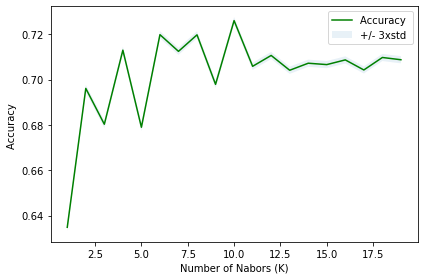

In [75]:
plt.plot(range(1,Ks),mean_acc,'g')
plt.fill_between(range(1,Ks),mean_acc - 1 * std_acc,mean_acc + 1 * std_acc, alpha=0.10)
plt.legend(('Accuracy ', '+/- 3xstd'))
plt.ylabel('Accuracy ')
plt.xlabel('Number of Nabors (K)')
plt.tight_layout()
plt.show()

We can see how the accuracy of the model trend to 0.9; so we will use the first K parameter in which it satarts remaining more or less stable: K=10

In [8]:
k=10
neigh = KNeighborsClassifier(n_neighbors = k).fit(X_train,y_train)

### Decision Tree

In [9]:
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics

The best accuracy was with 0.7422023802302588 with k= 8


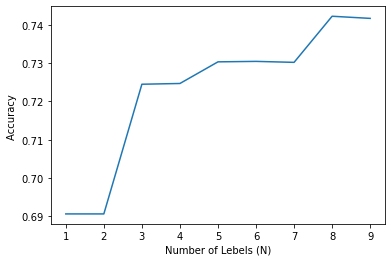

In [24]:
depth=10
acc=np.zeros((depth-1))

for n in range(1, depth):
    accidentsTree = DecisionTreeClassifier(criterion="entropy", max_depth = n)
    accidentsTree.fit(X_train,y_train)

    predTree=accidentsTree.predict(X_test)
    
    acc[n-1]=metrics.accuracy_score(y_test, predTree)

plt.plot(range(1,depth),acc)
plt.ylabel('Accuracy ')
plt.xlabel('Number of Lebels (N)')


print( "The best accuracy was with", acc.max(), "with k=", acc.argmax()+1) 

In [10]:
n=8

accidentsTree = DecisionTreeClassifier(criterion="entropy", max_depth = n)
accidentsTree.fit(X_train,y_train)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=8,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [79]:
!conda install -c conda-forge pydotplus

Solving environment: done

## Package Plan ##

  environment location: /opt/conda/envs/Python36

  added / updated specs: 
    - pydotplus


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2020.6.20  |       hecda079_0         145 KB  conda-forge
    certifi-2020.6.20          |   py36h9880bd3_2         151 KB  conda-forge
    python_abi-3.6             |          1_cp36m           4 KB  conda-forge
    openssl-1.1.1h             |       h516909a_0         2.1 MB  conda-forge
    pydotplus-2.0.2            |     pyhd1c1de3_3          23 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         2.4 MB

The following NEW packages will be INSTALLED:

    pydotplus:       2.0.2-pyhd1c1de3_3 conda-forge
    python_abi:      3.6-1_cp36m        conda-forge

The following packages will be UPDATED:

 

In [80]:
from sklearn.externals.six import StringIO
import pydotplus
import matplotlib.image as mpimg
from sklearn import tree
%matplotlib inline 

In [91]:
y_trainset=y_train.tostring()

In [92]:
dot_data = StringIO()
filename ="accidents_tree.png"
featureNames = feature_df.columns[0:7]
targetNames = feature_df["SEVERITYCODE"].unique().tolist()
out=tree.export_graphviz(accidentsTree,feature_names=featureNames, out_file=dot_data, class_names= np.unique(y_trainset), filled=True,  special_characters=True,rotate=False)  
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(filename)
img = mpimg.imread(filename)
plt.figure(figsize=(100, 200))
plt.imshow(img,interpolation='nearest')

IndexError: index 1 is out of bounds for axis 0 with size 1

### Logistic Regression

Text(0.5, 0, 'Inverse of regularization Strength (C)')

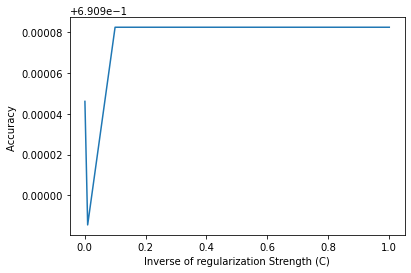

In [25]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import jaccard_similarity_score

C=[1,0.1,0.01,0.001]
accLR=np.zeros(len(C))
for i,n in enumerate(C):
    LR = LogisticRegression(C=n, solver='liblinear').fit(X_train,y_train)

    predLR = LR.predict(X_test)

    accLR[i]=jaccard_similarity_score(y_test, predLR)
    
plt.plot(C,accLR)
plt.ylabel('Accuracy ')
plt.xlabel('Inverse of regularization Strength (C)')

In [12]:
LR = LogisticRegression(C=0.1, solver='liblinear').fit(X_train,y_train)
LR

LogisticRegression(C=0.1, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=None, solver='liblinear',
          tol=0.0001, verbose=0, warm_start=False)

## Model Evaluation

In [13]:
from sklearn.metrics import jaccard_similarity_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss

In [16]:
precision={'Algorithm':['KNN','Decision Tree', 'Log Regr'], 'Jaccard':[0,0,0], 'F1-score':[0,0,0], 'LogLoss':[0,0,0]}


predKN=neigh.predict(X_test)
predTree=accidentsTree.predict(X_test)
predLR=LR.predict(X_test)

precision['Jaccard'][0]=jaccard_similarity_score(y_test, predKN)
precision['Jaccard'][1]=jaccard_similarity_score(y_test, predTree)
precision['Jaccard'][2]=jaccard_similarity_score(y_test, predLR)

precision['F1-score'][0]=f1_score(y_test, predKN, average='weighted')
precision['F1-score'][1]=f1_score(y_test, predTree, average='weighted')
precision['F1-score'][2]=f1_score(y_test, predLR, average='weighted')

precision['LogLoss'][2]=log_loss(y_test, predLR)

precision_df=pd.DataFrame.from_dict(precision)

precision_df

,Algotithm,Jaccard,F1-score,LogLoss
0,KNN,0.726079,0.684945,0.000000
1,Decision Tree,0.742227,0.682837,0.000000
2,Log Regr,0.690983,0.571706,23.855349


Falta por analizar confussion Matrix del modelo elegido o de los que están muy próximos en accuracy

In [18]:
precision_df.rename(columns={"Algotithm":"Algorithm"}, inplace=True)
precision_df

,Algorithm,Jaccard,F1-score,LogLoss
0,KNN,0.726079,0.684945,0.000000
1,Decision Tree,0.742227,0.682837,0.000000
2,Log Regr,0.690983,0.571706,23.855349


In [19]:
from sklearn.metrics import classification_report, confusion_matrix
import itertools
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

NameError: name 'yhat' is not defined

Confusion matrix, without normalization
[[53142  3789]
 [18790  6708]]
Confusion matrix, without normalization
[[55921  1010]
 [20238  5260]]
Confusion matrix, without normalization
[[56625   306]
 [25166   332]]


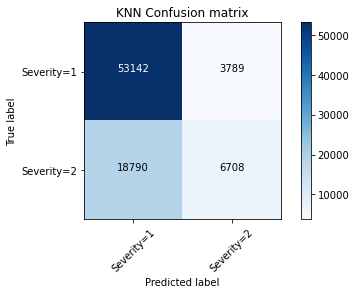

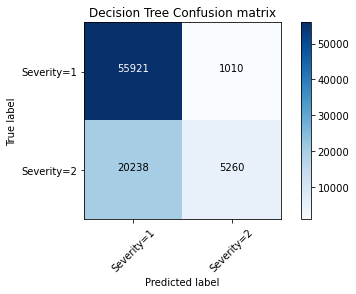

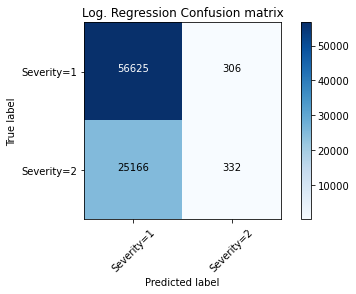

In [23]:
# Confusion Matrix for KNN
cnf_matrix = confusion_matrix(y_test, predKN, labels=[1,2])
np.set_printoptions(precision=2)

plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Severity=1','Severity=2'],normalize= False,  title='KNN Confusion matrix')

# Confusion Matrix for Decision Tree
cnf_matrix = confusion_matrix(y_test, predTree, labels=[1,2])
np.set_printoptions(precision=2)

plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Severity=1','Severity=2'],normalize= False,  title='Decision Tree Confusion matrix')

# Confusion Matrix for Logistic Regression
cnf_matrix = confusion_matrix(y_test, predLR, labels=[1,2])
np.set_printoptions(precision=2)

plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['Severity=1','Severity=2'],normalize= False,  title='Log. Regression Confusion matrix')